In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install h5py
!pip install typing-extensions
!pip install wheel

!pip install -r /content/drive/MyDrive/project/requirements.txt

     |████████████████████████████████| 51 kB 377 kB/s 
     |████████████████████████████████| 251 kB 10.2 MB/s 
     |████████████████████████████████| 462 kB 55.7 MB/s 
  Created wheel for data-preprocessing: filename=data_preprocessing-0.0.2-py3-none-any.whl size=4839 sha256=9df373eb033a9c608ff3988ace89f648faf5a2641cb4d6c5a7ee8fde70f32e62
  Stored in directory: /root/.cache/pip/wheels/d2/43/01/68e44dc30445fdc00258dde46da495f4a925379a3071cf102e
Successfully built data-preprocessing


In [3]:
# change path
import os  

project_fname = '/content/drive/MyDrive/project'
os.chdir(project_fname)
project_data_path = project_fname
print(os.getcwd())

/content/drive/MyDrive/project


In [4]:
import sys
# print(sys.path)
sys.path.append('/content/drive/MyDrive/project/')

In [5]:
# load data
import numpy as np
import random
from load_data import * 
from data_preprocessing_gan import * 
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn import preprocessing

X_test, y_test, person_train_valid, X_train_valid, y_train_valid, person_test = load_data(dir_path = project_data_path)

# normalize the data
N_trials,N_eeg,N_bins,_ = X_train_valid.shape
X_train_valid_norm = np.reshape(preprocessing.scale(np.reshape(X_train_valid,(N_trials*N_eeg,N_bins)),axis=1),(N_trials,N_eeg,N_bins,1))
N_trials,N_eeg,N_bins,_ = X_test.shape
X_test_norm = np.reshape(preprocessing.scale(np.reshape(X_test,(N_trials*N_eeg,N_bins)),axis=1),(N_trials,N_eeg,N_bins,1))


print ('Training/Valid data shape: {}'.format(X_train_valid.shape))
print ('Test data shape: {}'.format(X_test.shape))
print ('Training/Valid target shape: {}'.format(y_train_valid.shape))
print ('Test target shape: {}'.format(y_test.shape))
print ('Person train/valid shape: {}'.format(person_train_valid.shape))
print ('Person test shape: {}'.format(person_test.shape))

Training/Valid data shape: (2115, 22, 1000, 1)
Test data shape: (443, 22, 1000, 1)
Training/Valid target shape: (2115,)
Test target shape: (443,)
Person train/valid shape: (2115, 1)
Person test shape: (443, 1)


In [6]:
# DATA PREPROCESSING 

# Subsample and split into 1 person, 1 task
subsample = 5
subj = 0
task = 0 
X_train_valid_subsample, y_train_valid_subsample, person_train_valid_subsample = subsample_data(X_train_valid_norm,y_train_valid, person_train_valid, sample_every=subsample)
X_train, y_train, person_train = split_data_by_subject(X_train_valid_subsample, y_train_valid_subsample, person_train_valid_subsample)
X_train,y_train, person_train = split_data_by_task(X_train[subj],y_train[subj], person_train[subj])
X_train,y_train,person_train = X_train[task],y_train[task],person_train[task]
print('Shapes: x = {}, y = {}, person = {}'.format(X_train.shape, y_train.shape, person_train.shape))

# ONLY USE 5 EEG CHANNELS: 0 (Fz), 7 (C3), 9 (Cz), 11 (C4), 19 (Pz)
X_train = X_train[:,(0,7,9,11,19),:,:]

# wavelet transform 
N_trials,N_eeg,N_bins,_ = X_train.shape
fs = 250
freq_bins = 50
X_train_cwt = morlet_wavelet_transform(X_train,fs=fs,freq_range=(1,20),freq_bins=freq_bins,w=6)
# reshape for DCGAN 
X_train_cwt = np.swapaxes(np.swapaxes(X_train_cwt,1,3),1,2)
# scale between -1 and 1 for output of Generator
X_train_cwt_norm = 2 * (X_train_cwt - np.min(X_train_cwt,axis=0) ) / (np.max(X_train_cwt,axis=0) - np.min(X_train_cwt,axis=0)) - 1


print('X_cwt_norm = {}'.format(X_train_cwt_norm.shape))

Shapes: x = (300, 22, 200, 1), y = (300,), person = (300,)
Performing discrete CWT convolutions...


Trials:   0%|          | 0/300 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

X_cwt_norm = (300, 50, 200, 5)


CWT, eeg 0, person 0.0, task 0, trial 10


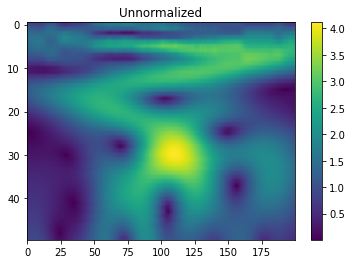

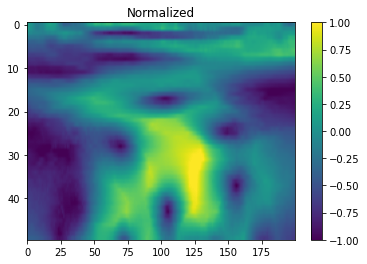

In [7]:
# DISPLAY EXAMPLES 
trial = 10
eeg = 0

# print('CWT, eeg {}, person {}, task {}, trial {}'.format(eeg,subj,task,trial))
print('CWT, eeg {}, person {}, task {}, trial {}'.format(eeg,person_train[trial],task,trial))
plt.figure(1)
plt.title('Unnormalized')
plt.imshow(X_train_cwt[trial,:,:,eeg],aspect='auto')
plt.colorbar()

plt.figure(2)
plt.title('Normalized')
plt.imshow(X_train_cwt_norm[trial,:,:,eeg],aspect='auto')
plt.colorbar()

In [8]:
# setup tensorflow + TPU 
%tensorflow_version 2.x
import tensorflow as tf
print("Tensorflow version " + tf.__version__)

try:
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
  print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
except ValueError:
  raise BaseException('ERROR: Not connected to a TPU runtime; please see the previous cell in this notebook for instructions!')

tf.config.experimental_connect_to_cluster(tpu)
tf.tpu.experimental.initialize_tpu_system(tpu)
tpu_strategy = tf.distribute.experimental.TPUStrategy(tpu)

Tensorflow version 2.8.0
Running on TPU  ['10.34.19.18:8470']
INFO:tensorflow:Deallocate tpu buffers before initializing tpu system.


INFO:tensorflow:Deallocate tpu buffers before initializing tpu system.


INFO:tensorflow:Initializing the TPU system: grpc://10.34.19.18:8470


INFO:tensorflow:Initializing the TPU system: grpc://10.34.19.18:8470


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Found TPU system:


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


In [9]:
## THIS CELL CONTAINS WGAN-DP CLASS -- it can evetually be turned into python script 
# Acknowledgment must be given to drewszurko: 
# github.com/drewszurko/tensorflow-WGAN-GP/blob/797e7c7c8c5861f3f55387635319972d9d224a8f/ops.py#L102

from tensorflow.keras import layers
from tensorflow.keras.losses import binary_crossentropy
import tensorflow.keras.backend as K 
from functools import partial
from tqdm import tqdm
from IPython.display import clear_output 
import time

class WGANGP(): 
  def __init__(self, noise_dim=100,dropout=0.2):   
    # setup config variables eg. noise_dim, hyperparams, verbose, plotting etc. 
    self.noise_dim = noise_dim
    self.dropout = dropout
    self.eeg_img_shape = (50,200,5)
        
    # setup history dictionary
    self.history = {}

    # build discriminator and generator models
    self.generator = self.build_generator()
    self.discriminator = self.build_discriminator()

  def build_generator(self):
    model = tf.keras.Sequential()
    model.add(layers.Dense(4*11*512, use_bias=False, input_shape=(self.noise_dim,)))
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    model.add(layers.Reshape((4, 11, 512)))
    assert model.output_shape == (None, 4, 11, 512) # Note: None is the batch size

    model.add(layers.Conv2DTranspose(256, (5, 4), strides=(2, 2), padding='valid', use_bias=False))
    assert model.output_shape == (None, 11, 24, 256)
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    model.add(layers.Conv2DTranspose(128, (5, 4), strides=(2, 2), padding='valid', use_bias=False))
    assert model.output_shape == (None, 25, 50, 128)
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    model.add(layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False))
    assert model.output_shape == (None, 50, 100, 64)
    model.add(layers.BatchNormalization())
    model.add(layers.ReLU())

    model.add(layers.Conv2DTranspose(5, (5, 5), strides=(1, 2), padding='same', use_bias=False, activation='tanh'))
    assert model.output_shape == (None, 50, 200, 5)

    return model

  def build_discriminator(self):
    model = tf.keras.Sequential()
    model.add(layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same', input_shape=self.eeg_img_shape))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    assert model.output_shape == (None,25,100,64) 

    model.add(layers.Conv2D(128, (5, 5), strides=(1, 2), padding='same'))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    model.add(layers.Dropout(self.dropout)) # output = (25, 50, 128)
    assert model.output_shape == (None,25,50,128) 

    model.add(layers.Flatten())
    model.add(layers.Dropout(self.dropout))
    model.add(layers.Dense(1))
    assert model.output_shape == (None,1) 
    
    return model
  
  # generate fake data after training! 
  def generate_fake_data(self,N=100): 
    noise = tf.random.normal([N, self.noise_dim]).numpy()
    return generator(noise, training=False).numpy(), noise 
    
  # loss functions
  def disc_loss(self, fake_logits, real_logits):
    return tf.reduce_mean(fake_logits) - tf.reduce_mean(real_logits)

  def gen_loss(self,fake_logits): 
    return - tf.reduce_mean(fake_logits)
  
  # gradient penalty term for discriminator 
  def gradient_penalty(self, discriminator, real_imgs, gen_imgs): 
    eps = tf.random.uniform([real_imgs.shape[0], 1, 1, 1], 0., 1.)
    inter = real_imgs + (eps * (real_imgs - gen_imgs))
    with tf.GradientTape() as tape: 
      tape.watch(inter)
      pred = discriminator(inter)
    
    grad = tape.gradient(pred,inter)[0]
    grad_l2_norm = tf.sqrt(tf.reduce_sum(tf.square(grad)))
    
    return tf.reduce_mean(grad_l2_norm) 

  # training functions
  # Notice the use of `tf.function`
  # This annotation causes the function to be "compiled".
  @tf.function
  def train_step(self,images):
    
    # loss variables to return
    disc_loss, disc_grads = 0,0
    
    # ---------------------
    #  Train Discriminator
    # ---------------------

    # train discriminator over several iterations 
    for _ in range(self.discriminator_iters):
      # setup gradient tools -- GradientTape automatically watches all trainable variables 
      with tf.GradientTape() as disc_tape:
        # forward prop
        noise = tf.random.normal([images.shape[0], self.noise_dim]) 
        gen_imgs = self.generator(noise, training=True)
        fake_logits = self.discriminator(gen_imgs, training=True)
        real_logits = self.discriminator(images, training=True)
        
        # calculate loss
        loss = self.disc_loss(fake_logits,real_logits)
        gp = self.gradient_penalty(partial(self.discriminator, training=True), images, gen_imgs)
        loss += self.gp_weight * gp 

      # back prop      
      disc_grads = disc_tape.gradient(loss, self.discriminator.trainable_variables)
      self.discriminator_optimizer.apply_gradients(zip(disc_grads,self.discriminator.trainable_variables))
      
      # save some variables for history 
      disc_loss += loss
      disc_grads += disc_grads

    # ---------------------
    #  Train Generator 
    # ---------------------
    noise = tf.random.normal([images.shape[0], self.noise_dim])
    with tf.GradientTape() as gen_tape:
      gen_imgs = self.generator(noise, training=True)
      fake_logits = self.discriminator(gen_imgs, training=True)
      gen_loss = self.gen_loss(fake_logits)

    gen_grads = gen_tape.gradient(gen_loss, self.generator.trainable_variables)
    self.generator_optimizer.apply_gradients(zip(gen_grads, self.generator.trainable_variables))

    return disc_loss, disc_grads[0], gen_loss, gen_grads[0]

  # training loop
  def train(self, train_dataset, generator_optimizer, discriminator_optimizer, 
            epochs=25, batch_size=128, discriminator_iters=5,
            gp_weight=0, plot=False, save_plots=False):
    '''
    Training loop
    INPUTS: 
    dataset - EEG training dataset as numpy array with shape=(trials,eeg,freq_bins,time_bins)
    '''

    # set up data for training
    dataset = tf.data.Dataset.from_tensor_slices(train_dataset.astype('float32')).shuffle(train_dataset.shape[0]).batch(batch_size)
    N_batch = np.ceil(train_dataset.shape[0]/float(batch_size))

    # save optimizers
    self.generator_optimizer = generator_optimizer
    self.discriminator_optimizer = discriminator_optimizer

    # save training variables 
    self.discriminator_iters = discriminator_iters
    self.gp_weight = gp_weight

    # setup history variables 
    history = self.history
    history['grads'], history['loss']= {}, {}
    gen_loss_history, disc_loss_history = [],[]
    gen_grads_history, disc_grads_history= [],[]
    
    # start training loop
    for epoch in range(epochs):
      start = time.time()
      
      # refresh loss for every epoch 
      gen_loss, disc_loss, disc_grads, gen_grads = 0, 0, 0, 0
     
      with tqdm(total=N_batch, position=0, leave=True) as pbar:
        for image_batch in dataset:

          # train step           
          disc_loss_batch, disc_grads_batch, gen_loss_batch, gen_grads_batch = self.train_step(image_batch)   
          
          # convert variables to usable format
          disc_loss_batch = tf.reduce_mean(disc_loss_batch).numpy()/float(self.discriminator_iters)
          disc_grads_batch = tf.reduce_mean(tf.sqrt(tf.reduce_sum(tf.square(disc_grads_batch)))).numpy()/float(self.discriminator_iters)
          gen_loss_batch = tf.reduce_mean(gen_loss_batch).numpy()
          gen_grads_batch = tf.reduce_mean(tf.sqrt(tf.reduce_sum(tf.square(gen_grads_batch)))).numpy()
          
          # store history 
          gen_loss += gen_loss_batch/float(N_batch)
          disc_loss += disc_loss_batch/float(N_batch)
          gen_grads += gen_grads_batch/float(N_batch)
          disc_grads += disc_grads_batch/float(N_batch)

          pbar.update()
      pbar.close()
      
      # store history 
      gen_loss_history.append(gen_loss)
      disc_loss_history.append(disc_loss)
      gen_grads_history.append(gen_grads)
      disc_grads_history.append(disc_grads) 
      

      print ('Epoch #: {}/{}, Time taken: {} secs,\n Grads: disc= {}, gen= {},\n Losses: disc= {}, gen= {}'\
             .format(epoch+1,epochs,time.time()-start, disc_grads, gen_grads, disc_loss, gen_loss))

      if plot and epoch % 20 == 0: 
        # fake image example
        generated_image, _ = self.generate_fake_data(N=1)       
        # real image example  
        trial_ind, eeg = 0, 0
        real_image = np.expand_dims(train_dataset[trial_ind], axis=0)
        
        # visualize fake and real data examples
        plt.figure()
        plt.subplot(121)
        plt.imshow(generated_image[0, :, :, eeg], aspect='auto')
        plt.colorbar()
        plt.title('Fake decision, eeg {}:\n {}'.format(eeg, self.discriminator(generated_image).numpy()))
        plt.subplot(122)
        plt.imshow(real_image[0,:,:,eeg], aspect='auto')
        plt.title('Real decision, trial {}, eeg {}:\n {}'.format(trial_ind, eeg, self.discriminator(real_image).numpy()))
        plt.colorbar()
        plt.subplots_adjust(hspace=0.5)
        plt.show()

        # plot discriminator classification
        gen_imgs, _ = self.generate_fake_data(N=train_dataset.shape[0])
        fake_predictions = self.discriminator(gen_imgs)
        real_predictions = self.discriminator(train_dataset)
        plt.figure()
        plt.plot(real_predictions.numpy(),'bo')
        plt.plot(fake_predictions.numpy(),'ro')
        plt.legend(['Real', 'Fake'])
        plt.show()

    # Generate after the final epoch
    clear_output(wait=True)
    
    plt.figure()
    plt.plot(gen_loss_history, 'r')
    plt.plot(disc_loss_history, 'b')
    plt.title('Loss history')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend(['Generator', 'Discriminator'])
    plt.show()

    plt.figure()
    plt.plot(gen_grads_history, 'r')
    plt.plot(disc_grads_history, 'b')
    plt.title('Gradient history')
    plt.xlabel('Epochs')
    plt.ylabel('Gradients (L2 norm)')
    plt.legend(['Generator', 'Discriminator'])
    plt.show()

    history['grads']['gen'], history['grads']['disc'] = gen_grads_history, disc_grads_history
    history['loss']['gen'], history['loss']['disc'] = gen_loss_history, disc_loss_history   
    
    self.history = history
    
    return history    

tf.Tensor([[0.00160568]], shape=(1, 1), dtype=float32)


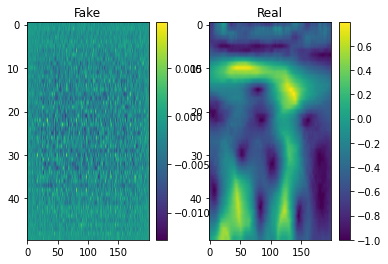

In [10]:
# test generator and discriminator 

import matplotlib.pyplot as plt

wgan = WGANGP(noise_dim=100, dropout=0.3)

generator = wgan.generator

generated_image, _ = wgan.generate_fake_data(N=1)

plt.subplot(121)
plt.imshow(generated_image[0, :, :, 0], aspect='auto')
plt.title('Fake')
plt.colorbar()
plt.subplot(122)
plt.imshow(X_train_cwt_norm[0,:,:,0], aspect='auto')
plt.title('Real')
plt.colorbar()

discriminator = wgan.discriminator

print (wgan.discriminator(generated_image))

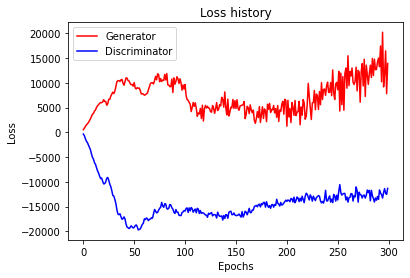

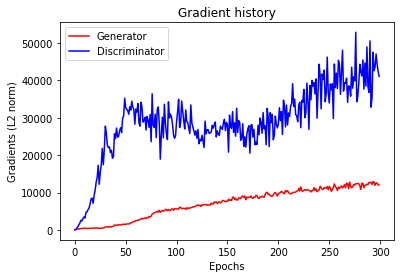

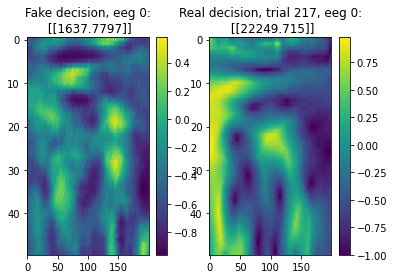

Saving generator weights to /content/drive/MyDrive/project/model_checkpoints/ckpt-WGANGP-CWT/generator_5eeg_person0_task0_10_27_31_07_03_2022.h5


Saving discriminator weights to /content/drive/MyDrive/project/model_checkpoints/ckpt-WGANGP-CWT/discriminator_5eeg_person0_task0_10_27_31_07_03_2022.h5


In [ ]:
# Main script containing 
import numpy as np
import random
from load_data import * 
from data_preprocessing import * 
import matplotlib.pyplot as plt
from datetime import datetime
from sklearn import preprocessing
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras import backend as K
import pickle

# clear backend 
try:
  del wgan
  K.clear_session()
except:
  pass

# init useful params
# decisions, loss_histories = [], []

# setup optimzers
gen_optim = Adam(1e-4, beta_1=0.5)
disc_optim = RMSprop(5e-4)

# setup model 
wgan = WGANGP(noise_dim=100, dropout=0.3)

generator = wgan.generator
discriminator = wgan.discriminator

# Training
print ('Starting training for task {}'.format(task))  
history = wgan.train(X_train_cwt_norm, gen_optim, disc_optim, 
            epochs=300, batch_size=100, discriminator_iters=5,
            gp_weight=10, plot=True)

# compare real and fake EEG data
eeg = 0 
# fake image example
generated_image, _ = wgan.generate_fake_data(N=1)       
# real image example
trial_ind = random.randint(0,X_train_cwt_norm.shape[0])
real_image = np.expand_dims(X_train_cwt_norm[trial_ind],axis=0)

# plotting
plt.figure()
plt.subplot(121)
plt.imshow(generated_image[0, :, :, eeg], aspect='auto')
plt.colorbar()
plt.title('Fake decision, eeg {}:\n {}'.format(eeg, wgan.discriminator(generated_image).numpy()))
plt.subplot(122)
plt.imshow(real_image[0,:,:,eeg], aspect='auto')
plt.title('Real decision, trial {}, eeg {}:\n {}'.format(trial_ind,eeg,wgan.discriminator(real_image).numpy()))
plt.colorbar()
plt.subplots_adjust(hspace=0.5)
plt.show()

# SAVE IMPORTANT THINGS
checkpoint_dir = 'model_checkpoints/ckpt-WGANGP-CWT/'
checkpoint_prefix = os.path.join(project_fname, checkpoint_dir)

# save generator and discriminator weights
time_rn = (datetime.strftime(datetime.now(),"%H_%M_%S_%d_%m_%Y"))
generator_fname = os.path.join(checkpoint_prefix,'generator_5eeg_person{}_task{}_{}.h5'.format(subj,task,time_rn))
print('Saving generator weights to {}'.format(generator_fname))
generator.save(generator_fname)
discriminator_fname = os.path.join(checkpoint_prefix,'discriminator_5eeg_person{}_task{}_{}.h5'.format(subj,task,time_rn))
print('Saving discriminator weights to {}'.format(discriminator_fname))
discriminator.save(discriminator_fname)

# save model performance history 
fname = os.path.join(checkpoint_prefix,'history_5eeg_person{}_task{}_{}'.format(subj,task,time_rn))
fileid = open(fname, 'ab') 
pickle.dump(history, fileid)
fileid.close()

Performing discrete CWT convolutions...


Trials:   0%|          | 0/300 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

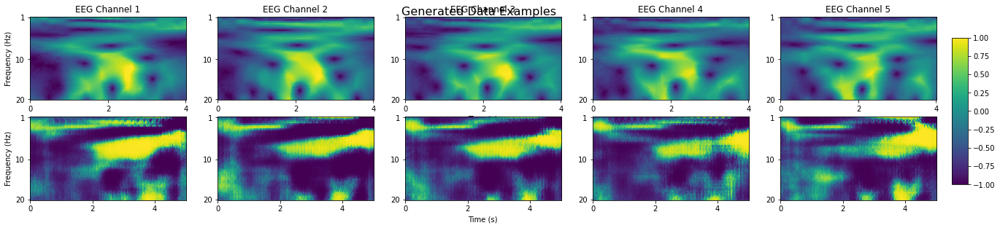

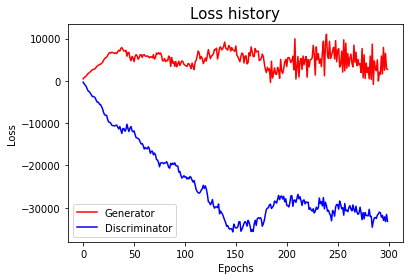

<Figure size 432x288 with 0 Axes>

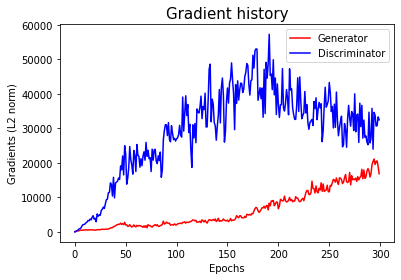

Performing discrete CWT convolutions...


Trials:   0%|          | 0/295 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

<Figure size 432x288 with 0 Axes>

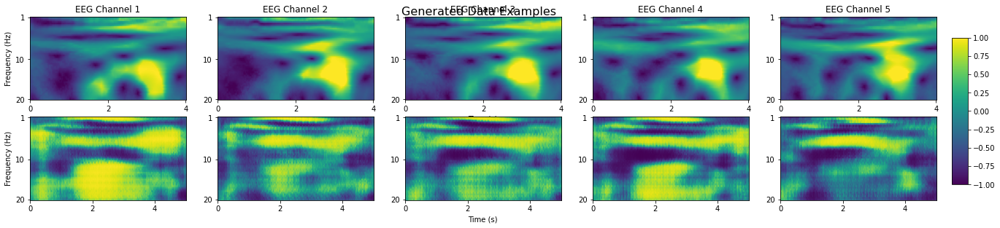

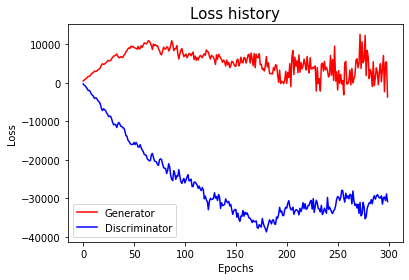

<Figure size 432x288 with 0 Axes>

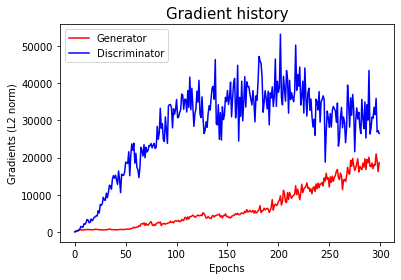

Performing discrete CWT convolutions...


Trials:   0%|          | 0/290 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

<Figure size 432x288 with 0 Axes>

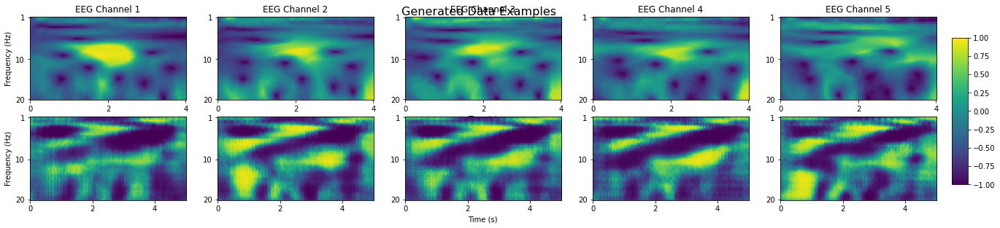

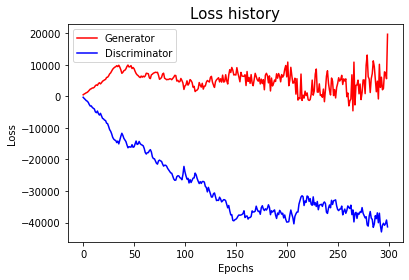

<Figure size 432x288 with 0 Axes>

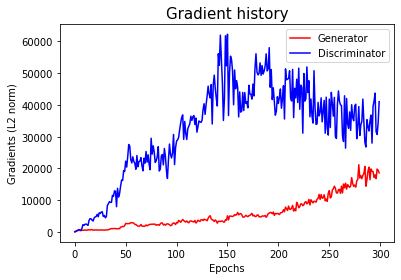

Performing discrete CWT convolutions...


Trials:   0%|          | 0/300 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

EEG Channel:   0%|          | 0/5 [00:00<?, ?it/s]

<Figure size 432x288 with 0 Axes>

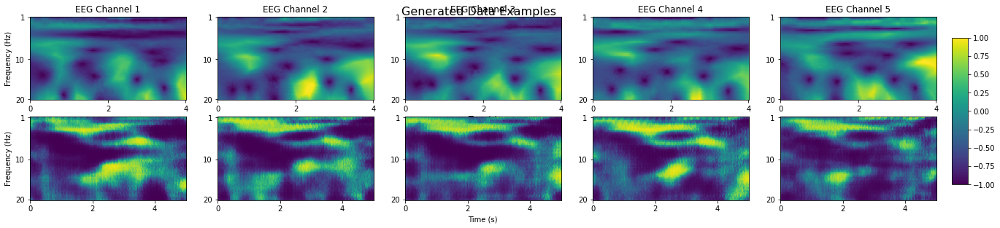

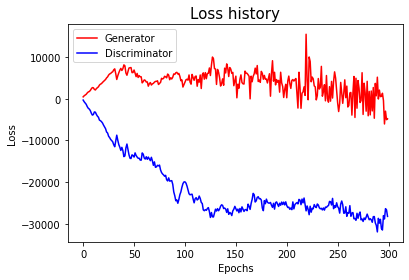

<Figure size 432x288 with 0 Axes>

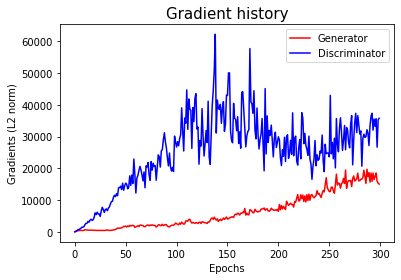

<Figure size 432x288 with 0 Axes>

In [12]:
import pickle

# GENERATE, PLOT AND SAVE DATA 
checkpoint_dir = 'model_checkpoints/ckpt-WGANGP-CWT/'
output_dir = 'model_checkpoints/ckpt-WGANGP-CWT/Out_imgs/'
output_prefix = os.path.join(project_fname, output_dir)
checkpoint_prefix = os.path.join(project_fname, checkpoint_dir)

gen_model_names = ['generator_5eeg_person0_task0_20_43_38_14_03_2022.h5',\
                   'generator_5eeg_person0_task1_21_19_01_14_03_2022.h5',\
                   'generator_5eeg_person0_task2_22_06_58_14_03_2022.h5',\
                   'generator_5eeg_person0_task3_22_42_02_14_03_2022.h5']

disc_model_names = ['discriminator_5eeg_person0_task0_20_43_38_14_03_2022.h5',\
                   'discriminator_5eeg_person0_task1_21_19_01_14_03_2022.h5',\
                   'discriminator_5eeg_person0_task2_22_06_58_14_03_2022.h5',\
                   'discriminator_5eeg_person0_task3_22_42_02_14_03_2022.h5']

history_model_names = ['history_5eeg_person0_task0_20_43_38_14_03_2022',\
                   'history_5eeg_person0_task1_21_19_01_14_03_2022',\
                   'history_5eeg_person0_task2_22_06_58_14_03_2022',\
                   'history_5eeg_person0_task3_22_42_02_14_03_2022']

for task in range(4): 

  # create 100 fake data points 
  N = 100; 
  gen_loaded = tf.keras.models.load_model(os.path.join(checkpoint_prefix, gen_model_names[task]))
  disc_loaded = tf.keras.models.load_model(os.path.join(checkpoint_prefix, disc_model_names[task]))
  fileid = open(os.path.join(checkpoint_prefix,history_model_names[task]),'rb')
  history_loaded = pickle.load(fileid)
  noise = tf.random.normal([N, 100])  
  gen_imgs = gen_loaded(noise, training=False).numpy()

  # save data in .npy, shape=(trials, freq_bins, time_bins, eegs)
  fname = os.path.join(output_prefix, 'X_artificial_task{}_subj0_eegs5.npy'.format(task))
  np.save(fname, gen_imgs)

  # real images
  subj = 0
  subsample = 5
  X_train_valid_subsample, y_train_valid_subsample, person_train_valid_subsample = subsample_data(X_train_valid_norm,y_train_valid, person_train_valid, sample_every=subsample)
  X_train, y_train, person_train = split_data_by_subject(X_train_valid_subsample, y_train_valid_subsample, person_train_valid_subsample)
  X_train,y_train, person_train = split_data_by_task(X_train[subj],y_train[subj], person_train[subj])
  X_train,y_train,person_train = X_train[task],y_train[task],person_train[task]

  # ONLY USE 5 EEG CHANNELS: 0 (Fz), 7 (C3), 9 (Cz), 11 (C4), 19 (Pz)
  X_train = X_train[:,(0,7,9,11,19),:,:]

  # wavelet transform 
  N_trials,N_eeg,N_bins,_ = X_train.shape
  fs = 250
  freq_bins = 50
  X_train_cwt = morlet_wavelet_transform(X_train,fs=fs,freq_range=(1,20),freq_bins=freq_bins,w=6)
  # reshape for DCGAN 
  X_train_cwt = np.swapaxes(np.swapaxes(X_train_cwt,1,3),1,2)
  # scale between -1 and 1 for output of Generator
  X_train_cwt_norm = 2 * (X_train_cwt - np.min(X_train_cwt,axis=0) ) / (np.max(X_train_cwt,axis=0) - np.min(X_train_cwt,axis=0)) - 1

  # plot and save fig fake data example for each EEG
  fig, ax = plt.subplots(2,5)
  for eeg in range(5): 
    # plotting real data
    img = ax[0][eeg].imshow(X_train_cwt_norm[10, :, :, eeg], vmin=-1, vmax=1, aspect='auto')
    ax[0][eeg].set_title('EEG Channel {}'.format(eeg+1))
    ax[0][eeg].set_xticks([0,100,199])
    ax[0][eeg].set_xticklabels(['0', '2', '4'])
    ax[0][eeg].set_yticks([0,25,49])
    ax[0][eeg].set_yticklabels(['1', '10','20'])
    # plotting fake data
    img = ax[1][eeg].imshow(gen_imgs[2, :, :, eeg], vmin=-1, vmax=1, aspect='auto')
    ax[1][eeg].set_xticks([0,100,199])
    ax[1][eeg].set_xticklabels(['0', '2', '4'])
    ax[1][eeg].set_yticks([0,25,49])
    ax[1][eeg].set_yticklabels(['1', '10','20'])
    if eeg==0: 
      ax[0][eeg].set_ylabel('Frequency (Hz)')
      ax[1][eeg].set_ylabel('Frequency (Hz)')
    elif eeg==2: 
      ax[0][eeg].set_xlabel('Time (s)')
      ax[1][eeg].set_xlabel('Time (s)')
    
  fig.subplots_adjust(top=1.0, right=3.0)
  cbar_ax = fig.add_axes([3.05, 0.2, 0.05, 0.7])
  fig.colorbar(img, cax=cbar_ax)
  fig.suptitle('Generated Data Examples', x=1.55, y=1.05, fontsize=16)
  plt.show()
  fname = os.path.join(output_prefix, 'genImgs_task{}_subj0_eegs5.png'.format(task))
  fig.savefig(fname, bbox_inches = 'tight')

  # plot and save loss and gradient history 
  gen_grads_history, disc_grads_history = history_loaded['grads']['gen'], history_loaded['grads']['disc']
  gen_loss_history, disc_loss_history = history_loaded['loss']['gen'], history_loaded['loss']['disc']  

  plt.figure()
  plt.plot(gen_loss_history, 'r')
  plt.plot(disc_loss_history, 'b')
  plt.title('Loss history',fontsize=15)
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.legend(['Generator', 'Discriminator'])
  plt.show()
  fname = os.path.join(output_prefix, 'lossHistory_task{}_subj0_eegs5.png'.format(task))
  plt.savefig(fname, bbox_inches = 'tight')

  plt.figure()
  plt.plot(gen_grads_history, 'r')
  plt.plot(disc_grads_history, 'b')
  plt.title('Gradient history',fontsize=15)
  plt.xlabel('Epochs')
  plt.ylabel('Gradients (L2 norm)')
  plt.legend(['Generator', 'Discriminator'])
  plt.show()
  fname = os.path.join(output_prefix, 'gradHistory_task{}_subj0_eegs5.png'.format(task))
  plt.savefig(fname, bbox_inches = 'tight')

In [13]:
# model summaries
generator.summary()
discriminator.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 22528)             2252800   
                                                                 
 batch_normalization (BatchN  (None, 22528)            90112     
 ormalization)                                                   
                                                                 
 re_lu (ReLU)                (None, 22528)             0         
                                                                 
 reshape (Reshape)           (None, 4, 11, 512)        0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 11, 24, 256)      2621440   
 nspose)                                                         
                                                                 
 batch_normalization_1 (Batc  (None, 11, 24, 256)      1

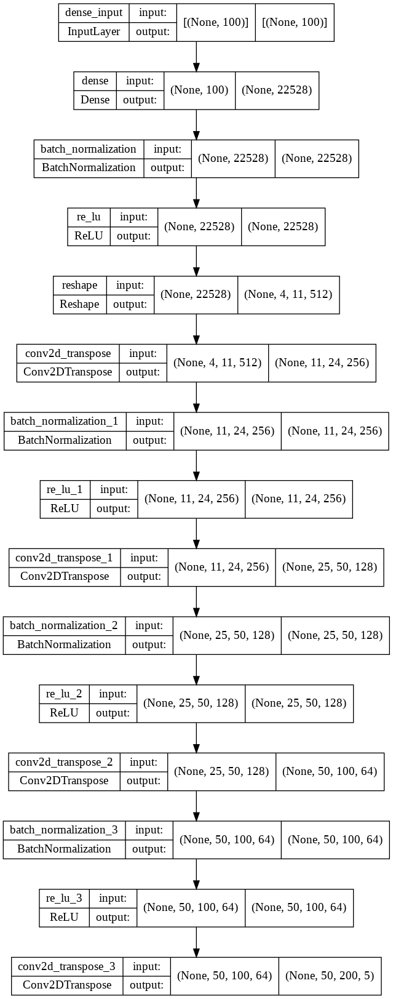

In [ ]:
from tensorflow.keras.utils import plot_model

plot_model(wgan.generator, show_shapes=True, expand_nested=True)

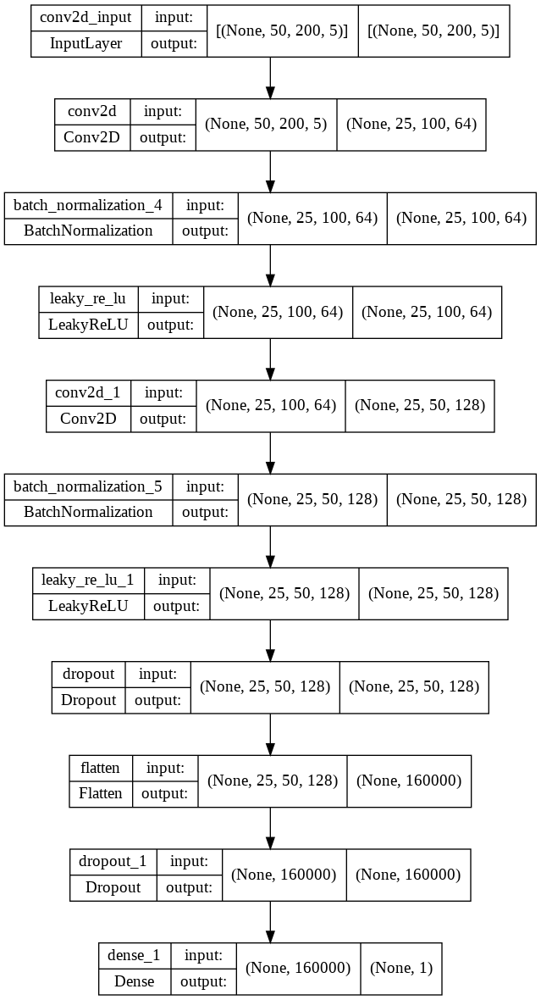

In [ ]:
plot_model(wgan.discriminator, show_shapes=True, expand_nested=True)